## Copyright 2019 Investigating NMT Representations at Scale Authors.

Licensed under the Apache License, Version 2.0 (the "License");

Copyright 2019 Investigating NMT Representations at Scale Authors. All Rights Reserved.

Licensed under the Apache License, Version 2.0 (the "License"); you may not use this file except in compliance with the License. You may obtain a copy of the License at http://www.apache.org/licenses/LICENSE-2.0

Unless required by applicable law or agreed to in writing, software distributed under the License is distributed on an "AS IS" BASIS, WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied. See the License for the specific language governing permissions and limitations under the License.


# Introduction


In this work, we attempt to peek into the black-box of massively multilingual NMT models, trained on over 100 languages, with the lens of SVCCA. We attempt to answer:
<!-- % the following questions: -->

* Which factors determine the extent of overlap in the learned representations?
<!-- % learned in multilingual NMT models? -->
* Is the extent of representational overlap similar throughout the model?
* How robust are multilingual NMT representations to fine-tuning on an arbitrary other language?

<!-- % , and does fine-tuning cause a drift for other languages? -->

Answers to the above questions might have large implications on how we approach multilingual models and cross lingual transfer learning. Our work is the first that attempts to understand the nature of multilingual representations and cross-lingual transfer in deep neural networks, based on analyzing a model trained on over 100 languages simultaneously.


## Imports

In [0]:
# Use this once uploaded
%%bash 
test -d gresearch || git clone https://github.com/google-research/google-research gresearch && mv gresearch/investigating_m4 ./

bash: line 1: git: command not found


In [0]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

from io import StringIO
import os
import random
import string
import numpy as np
import pandas as pd
import seaborn
import cPickle as pickle
from pprint import pprint
import operator
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import zipfile

In [0]:
from investigating_m4 import create_plots
from sklearn import metrics, cluster, manifold
from tensorflow import gfile

In [0]:
from bokeh.plotting import output_notebook, figure, show, output_file

## Vars

In [0]:
# This is a list of layers whose activations we have studied.
# enc: Encoder; dec: Decoder
# tok: Token Token Embedding + Positional Embedding
# out_i: ith layer in encoder or decoder

activation_list = ['enc/tok', 'enc/inp', 'enc/out_0', 'enc/out_1',
       'enc/out_2', 'enc/out_3', 'enc/out_4', 'enc/out_5',
       'dec/tok','dec/inp',   'dec/out_0', 'dec/out_1',
       'dec/out_2', 'dec/out_3', 'dec/out_4', 'dec/out_5']

# Data and Model

We  study  multilingual NMT on a massive scale, using an in-house training corpus which was generated by crawling and extracting parallel sentences from the web. Our dataset contains more than 20 billion sentence pairs for over a hundred languages to and from English, adding up to more than 100 direct language pairs. 

Having been crawled from the web, our dataset has some important characteristics worth mentioning. 

1. **Heavy imbalance** between language pairs; the number of parallel sentences per language pair ranges between $10^4$ to $10^9$. Although this skew introduces optimization challenges, it also creates a plausible setup for maximizing the positive language transfer from high-resource to low-resource language pairs, making it possible to study low-resource languages, that would otherwise have been very low quality.
2. **Diversity:** our corpus has languages belonging to a wide variety of scripts and linguistic families. These characteristics of our dataset make the problem that we study as realistic as possible. Models trained on this massive open-domain dataset are expected to yield rich, complex representations which we attempt to study in this paper.

#### Multiway Dataset
In order to minimize confounding factors and control the evaluation set size and domain, we created our evaluation set as a multi-way aligned dataset containing more than 3k sentence pairs for all languages (Each sentence in our evaluation set is semantically identical across all other languages). This also allows us to analyze the representational difference and similarity while controlling for semantics.

#### Model
We use the Transformer-Big architecture for our experiments and share all parameters across language pairs including softmax layer and input/output word embeddings. For vocabulary, we use a Sentence Piece Model with 64k tokens shared on both the encoder and decoder side. 

Each set of parallel sentences has a target token <2xx>  prepended to the source sentence to indicate the intended target language.

## Load Data

In [0]:
DIR = 'investigating_m4'
def extract_file(zf, dirname, filename):
  try:
      data = zf.read(os.path.join(dirname, filename))
  except KeyError:
      print('ERROR: Did not find %s in zip file' % filename)
  else:
      rows = [x.split(',') for x in data.split('\n')]
      df = pd.DataFrame(rows[1:], columns=rows[0])
  return df

In [0]:
from google.colab import auth
auth.authenticate_user()
project_id = 'investigating-m4'
!gcloud config set project {project_id}
!gsutil ls

In [0]:
bucket_name = 'investigating-m4'
!gsutil -m cp -r gs://investigating-m4/investigating_m4.zip ./

In [0]:
# Load zip file and extract it.
with open('investigating_m4.zip') as f:
  zf = zipfile.ZipFile(f)

  prop_df = extract_file(zf, DIR, 'properties.csv')
  data = extract_file(zf, DIR, 'model_scores.csv')
  df_ft = extract_file(zf, DIR, 'finetuned_model_scores.csv')
  bleu_rel = extract_file(zf, DIR, 'finetuned_relative_bleu.csv')

In [0]:
data['SVCCA Score'] = pd.to_numeric(data['SVCCA Score'], errors='coerce')
df_ft['SVCCA Score'] = pd.to_numeric(df_ft['SVCCA Score'], errors='coerce')
bleu_rel['Relative BLEU Change'] = pd.to_numeric(bleu_rel['Relative BLEU Change'], errors='coerce')

## Languages Studied

In [0]:
ALL_LANGS = ['af', 'am', 'ar', 'az', 'be', 'bg', 'bn', 'ca', 'ceb', 'co', 'cs', 'cy', 'da', 'de', 'el', 'eo', 'es', 'et', 'eu', 'fa', 'fi', 'fr', 'fy', 'ga', 'gd', 'gl', 'gu', 'ha', 'haw', 'hi', 'hmn', 'hr', 'ht', 'hu', 'hy', 'id', 'ig', 'is', 'it', 'iw', 'ja', 'jw', 'ka', 'kk', 'km', 'kn', 'ko', 'ku', 'ky', 'lb', 'lo', 'lt', 'lv', 'mg', 'mi', 'mk', 'ml', 'mn', 'mr', 'ms', 'mt', 'my', 'ne', 'nl', 'no', 'ny', 'pa', 'pl', 'ps', 'pt', 'ro', 'ru', 'sd', 'si', 'sk', 'sl', 'sm', 'sn', 'so', 'sq', 'sr', 'st', 'su', 'sv', 'sw', 'ta', 'te', 'tg', 'th', 'tl', 'tr', 'uk', 'ur', 'uz', 'vi', 'xh', 'yi', 'yo', 'zh', 'zu']
lps_enx = ["en-%s" % lang for lang in ALL_LANGS]
lps_xen = ["%s-en" % lang for lang in ALL_LANGS]
lps = lps_enx + lps_xen

In [0]:
# These are some selected language pairs from a diverse range of resource sizes,
# scripts and language families.
plotting_groups = {}
plotting_groups['xen_int'] = ['ny-en', 'yo-en', 'ha-en', 'gd-en', 'ig-en', 'ru-en', 'sr-en', 'az-en', 'uk-en', 'ca-en', 'mr-en', 'km-en', 'uz-en', 'so-en', 'ky-en', 'es-en', 'tr-en', 'pl-en', 'ko-en', 'ar-en']
plotting_groups['enx_int'] = ['en-ny', 'en-ne', 'en-st', 'en-ps', 'en-sm', 'en-it', 'en-pt', 'en-nl', 'en-ar', 'en-id', 'en-mr', 'en-so', 'en-yi', 'en-am', 'en-yo', 'en-fr', 'en-de', 'en-zh', 'en-tr', 'en-pl']

In [0]:
# Language pairs with which we finetune.
# These are some selected language pairs from a diverse range of resource sizes,
# scripts and language families.
ft_lps =['en-fr',
 'en-de',
 'en-it',
 'en-pt',
 'en-nl',
 'en-zh',
 'en-tr',
 'en-pl',
 'en-ar',
 'en-id',
 'en-mr',
 'en-yi',
 'en-am',
 'en-ny',
 'en-so',
 'en-ne',
 'en-st',
 'en-ps',
 'en-sm',
 'en-yo',
 'es-en',
 'ru-en',
 'tr-en',
 'pl-en',
 'sr-en',
 'ko-en',
 'ar-en',
 'az-en',
 'uk-en',
 'ca-en',
 'mr-en',
 'km-en',
 'uz-en',
 'so-en',
 'ky-en',
 'ny-en',
 'yo-en',
 'ha-en',
 'gd-en',
 'ig-en']

In [0]:
# Order in which lps appear in finetuning figures
order = ['eu-en', 'hu-en', 'fi-en', 'et-en', 'tr-en', 'az-en', 'kk-en',
'uz-en', 'ky-en', 'zh-en', 'my-en', 'yo-en', 'ig-en', 'sw-en',
'st-en', 'zu-en', 'xh-en', 'sn-en', 'ny-en', 'mn-en', 'th-en',
'lo-en', 'ko-en', 'ka-en', 'ja-en', 'ru-en', 'sk-en', 'pl-en',
'sr-en', 'cs-en', 'hr-en', 'uk-en', 'bg-en', 'sl-en', 'be-en',
'mk-en', 'es-en', 'fr-en', 'it-en', 'pt-en', 'ro-en', 'ca-en',
'gl-en', 'ht-en', 'co-en', 'hi-en', 'fa-en', 'ur-en', 'bn-en',
'ku-en', 'gu-en', 'ps-en', 'mr-en', 'si-en', 'pa-en', 'ne-en',
'tg-en', 'sd-en', 'el-en', 'de-en', 'nl-en', 'sv-en', 'da-en',
'no-en', 'af-en', 'is-en', 'fy-en', 'yi-en', 'lb-en', 'cy-en',
'ga-en', 'gd-en', 'lt-en', 'lv-en', 'hy-en', 'sq-en', 'hmn-en',
'te-en', 'ta-en', 'kn-en', 'ml-en', 'eo-en', 'id-en', 'ceb-en',
'ms-en', 'tl-en', 'jw-en', 'mg-en', 'su-en', 'mi-en', 'sm-en',
'haw-en', 'vi-en', 'km-en', 'ar-en', 'iw-en', 'mt-en', 'am-en',
'so-en', 'ha-en', 'en-eu', 'en-hu', 'en-fi', 'en-et', 'en-tr',
'en-az', 'en-kk', 'en-ky', 'en-uz', 'en-zh', 'en-my', 'en-yo',
'en-ig', 'en-sw', 'en-zu', 'en-sn', 'en-xh', 'en-ny', 'en-st',
'en-mn', 'en-th', 'en-lo', 'en-ko', 'en-ka', 'en-ja', 'en-ru',
'en-pl', 'en-cs', 'en-sr', 'en-sk', 'en-uk', 'en-bg','en-sl',
'en-hr', 'en-be', 'en-mk', 'en-es', 'en-fr', 'en-it', 'en-pt',
'en-ro', 'en-ca', 'en-gl', 'en-ht', 'en-co', 'en-hi', 'en-fa',
'en-ur', 'en-bn', 'en-ku', 'en-gu', 'en-si', 'en-pa', 'en-mr',
'en-tg', 'en-ne', 'en-ps', 'en-sd', 'en-el', 'en-de', 'en-nl',
'en-sv', 'en-da', 'en-no', 'en-is', 'en-af', 'en-fy', 'en-yi',
'en-lb', 'en-cy', 'en-ga', 'en-gd', 'en-lt', 'en-lv', 'en-hy',
'en-sq', 'en-hmn', 'en-te', 'en-ta', 'en-kn', 'en-ml', 'en-eo',
'en-id', 'en-ms', 'en-tl', 'en-mg', 'en-ceb','en-mi', 'en-jw',
'en-sm', 'en-haw', 'en-su', 'en-vi', 'en-km', 'en-ar', 'en-iw',
'en-mt', 'en-am', 'en-so', 'en-ha']



## SVCCA for Sequences

SVCCA was originally proposed for feed-forward neural networks, but our domain requires dealing with sequences. A simple approximation to summarize a set of activations is to apply a pooling operation over the set. We perform SVCCA on the hidden representations of the model, averaged over sequence time-steps, for each sentence in our evaluation set.

### SVCCA across Languages
In all known work applying SVCCA, representations of the same data are used for analysis. However, in order to compare representations across languages, we leverage our multi-way parallel evaluation set to compare representations across different languages, since each data point is semantically equivalent (our multi-way parallel evaluation set).

# Representations Cluster by Language Similarity

In this section, we use SVCCA to examine the relationship between representations of different languages learned by our massively multilingual NMT model. We compute SVCCA scores of layer-wise activations of a fully trained model between 101 languages pairs in both the Any-to-English and English-to-Any directions.*

We first visualize the relationship between languages in their representation space for each layer using Spectral Embeddings. In our case, we use mean SVCCA scores as a similarity measure. Due to the differing nature of translating multiple languages to English and vice versa, the representation space of these two sets of languages, All-to-English and English-to-Any, behave differently and separate quite clearly (Appendix of the paper). We first visualize the encoder representation of all languages in the All-to-English language pair set. For the sake of analysis, we then visualize subsets of the aforementioned 101 languages. We include visualizations of representations extracted from the embeddings and top layers of the encoder and decoder in the Appendix of the paper.


*Our multilingual NMT model is trained on the available training data which is English centric, hence an All-to-All multilingual model internally decomposes into All-to-English (X-En) and English-to-All (En-X) translation bundles excluding zero-shot directions.

## What is Language Similarity?

In the following sections we draw comparisons between the representational similarity of languages learnt by our models, and the linguistic similarity between those languages. While there are entire sub-fields in linguistics devoted to studying similarity (e.g. Comparative Linguistics and Linguistic Typology), in this paper we define language similarity in terms of membership in the same language family (e.g. Turkic languages), or branch within that family (e.g. Oghuz Turkic languages). Families are groups of languages believed to share a common ancestor, and therefore tend to have similar vocabulary and grammatical constructs.

We also discuss writing systems, including scripts like Cyrillic, Roman, and Ge'ez. While similar languages frequently share the same script, that is not always true. Note that all of these categories are muddled by a variety of factors that are difficult to tease apart, and might be affected by the web-crawled data that we train on. For instance, languages sharing a script may also be part of the same political bloc, influencing what text is available on the web. This and other confounding factors make a rigorous comparison exceedingly difficult. For brevity, we label languages in images with their BCP-47 language codes, which are enumerated in the Appendix of the paper.

### Linguistically Motivated Coloring Functions

In [0]:
# Here are various custom coloring functions for different interesting language
# groupings. They all follow the following convention:
#
# input: a language pair, like 'te-en'
# output: a string like 'Dravidian', or 'Unknown' if the langauge pair in
#         question is not handled by this function.


def get_property(lp, prop_type):
  return prop_df[prop_df['Language Code'] == create_plots.non_english_lang(lp)][prop_type].values[0]


def generic_family_colorer(lp):
  # colors by the "family" attribute in the language dossier. 
  return get_property(lp, 'Family')

def generic_subfamily_colorer(lp):
  # colors by the "subfamily" attribute in the language dossier. Since this
  # grouping is sort of heuristic*, we define a few better colorers for specific
  # subgroups below. See note on generic_family_colorer above.
  #
  # * What's a family and what's a subfamily? These are not clear-cut
  #   distinctions, but often historical conventions.
  return get_property(lp, 'Sub-Family')


def familylike_custom_colorer(lp):
  # Colors by four different langauge groups: Iranian, Semitic, Indic, and Dravidian. 
  cats = {
      'Iranian': {'fa', 'ps', 'ku', 'tg'},
      'Semitic': {'iw', 'ar', 'am', 'mt'},
      'Indic': {'ur', 'bn', 'ne', 'pa', 'hi', 'mr', 'gu', 'sd', 'si'},
      'Dravidian': {'kn', 'ml', 'ta', 'te'},
  }
  inverted_cats = {lang:cat for cat in cats for lang in cats[cat]}
  return inverted_cats.get(create_plots.non_english_lang(lp), 'Unknown')


def get_tasks_from_properties(prop_type, prop_options, lang_options=ALL_LANGS):
  """ Select all LPs that have a certain property from within a certain property
  type, a.g. whose family (prop_type) is in ['Turkic', 'Indo-European']
  (prop_options)
  """
  # assert prop_type in language_dossier.LANGUAGE_DOSSIER['af'] # make sure that all languages have this propery
  langs = [lang for lang in lang_options if  prop_df[prop_df['Language Code'] == lang][prop_type].values[0] in prop_options]
  return [lp for lp in lps if (create_plots.non_english_lang(lp) in langs)]

def finegrain_dravidoindoiranian_colorer(lp) :
  # Fine-grained Colorer for Indoiranian and Dravidian languages.
  return {
      'kn': 'Kannada–Badaga ',
      'ml': 'Tamil–Kodagu ',
      'ta': 'Tamil–Kodagu ',
      'te': 'South-Central Dravidian',
      'bn': 'Bengali–Assamese',
      'fa': 'Persian',
      'gu': 'West-Central Indic',
      'hi': 'West-Central Indic',
      'ku': 'Northwestern Iranian',
      'mr': 'Marathi-Konkani',
      'ne': 'Northern Indic',
      'pa': 'Northwestern Indic',
      'ps': 'Southwestern Iranian',
      'sd': 'Northwestern Indic',
      'si': 'Insular Indic',
      'tg': 'Persian',
      'ur': 'West-Central Indic'
  }.get(create_plots.non_english_lang(lp), 'Unknown')

def finegrain_slavoturkic_colorer(lp):
  # Fine-grained colorer for Turkic and Slavic languages.
  # Also includes Farsi, Tajik and Mongolian.
  return {
      'ru': 'East Slavic',
      'ky': 'Kipchak',
      'bg': 'Southeast Slavic',
      'tg': 'Persian',
      'az': 'Oghuz',
      'sl': 'Western Slavic',
      'kk': 'Kipchak',
      'be': 'East Slavic',
      'mk': 'Southeast Slavic',
      'sr': 'Western Slavic',
      'pl': 'West Slavic',
      'tr': 'Oghuz',
      'uk': 'East Slavic',
      'mn': 'Mongolic',
      'hr': 'Western Slavic',
      'uz': 'Karluk',
      'cs': 'West Slavic',
      'sk': 'West Slavic',
      'fa': 'Persian'
  }.get(create_plots.non_english_lang(lp), 'Unknown')

def script_colorer(lp):
  # colors by the "script" attribute in the language dossier (e.g. Roman, Arabic, etc.).
  return get_property(lp, 'Script')


print ("Let's look at Telugu ('te') with our various colorers, with increasing levels of granularity:")
print (generic_family_colorer('te-en'))
print (familylike_custom_colorer('te-en'))
print (generic_subfamily_colorer('te-en'))
print (finegrain_dravidoindoiranian_colorer('te-en'))
print (finegrain_slavoturkic_colorer('te-en'))
print (script_colorer('te-en'))



Let's look at Telugu ('te') with our various colorers, with increasing levels of granularity:
Dravidian
Dravidian
South-Central Dravidian
South-Central Dravidian
Unknown
Telugu


### Some Language Groupings

In [0]:
# These are the language groupings we visualize in the paper
slavic_lps=['ru-en', 'bg-en',  'sl-en', 'be-en', 'mk-en', 'sr-en', 'pl-en',  'uk-en', 'hr-en','cs-en']
slavoturkic_lps = ['ru-en', 'ky-en', 'bg-en', 'az-en', 'sl-en', 'kk-en', 'be-en', 'mk-en', 'sr-en', 'pl-en', 'tr-en', 'uk-en', 'hr-en', 'uz-en', 'cs-en']
dravidian_lps = ['kn-en', 'ml-en', 'te-en', 'ta-en']
indoiranian_lps = ['ku-en', 'pa-en', 'ps-en', 'hi-en', 'ur-en', 'mr-en', 'sd-en', 'bn-en', 'si-en', 'gu-en', 'tg-en', 'fa-en', 'ne-en']
dravidoindoiranian_lps = dravidian_lps + indoiranian_lps
germanic_romance_indoiranian_lps = ['af-en', 'bn-en', 'ca-en', 'co-en', 'da-en', 'de-en', 'es-en', 'fa-en', 'fr-en', 'fy-en', 'gl-en', 'gu-en', 'hi-en', 'ht-en', 'is-en', 'it-en', 'ku-en', 'lb-en', 'mr-en', 'ne-en', 'nl-en', 'no-en', 'pa-en', 'ps-en', 'pt-en', 'ro-en', 'sd-en', 'si-en', 'sv-en', 'tg-en', 'ur-en', 'yi-en']

In [0]:
# This cell separates the DataFrame data by layer (activation_list) and reshapes it into
# form convenient for plotting.
cross_dfs = {}

for aname in activation_list:
  cross_dfs[aname] = data[data.Layer==aname][['Language Pair 1', 'Language Pair 2', 'SVCCA Score']].set_index(['Language Pair 1', 'Language Pair 2']).unstack()

## Encoder Plots

**Note:** In this section we cluster various sets of language pairs. We label each figure with the corresponding Figure in the paper.

We first visualize a clustering for all languages together. While there are a few outliers, we can observe some overlapping clusters, including the Slavic cluster on the top-left, the Germanic and Romance clusters on the bottom-left, the Indo-Aryan and Dravidian clusters on the top-right, etc. To analyze language clustering in more detail we visualize sub-sets of the above languages.

In [0]:
#@title All languages by subfamily (Fig. 2)

%enable_bokeh
output_notebook()

selected_lps = lps_xen
print(selected_lps)
f = create_plots.get_visualizations(
                  cross_dfs,
                  activation_list=['enc/tok', 'enc/out_5'],
                  lp_subset=selected_lps, 
                  property_mapper=generic_subfamily_colorer,
                  dotsize=10)

show(f)


Loading BokehJS ...

['af-en', 'am-en', 'ar-en', 'az-en', 'be-en', 'bg-en', 'bn-en', 'ca-en', 'ceb-en', 'co-en', 'cs-en', 'cy-en', 'da-en', 'de-en', 'el-en', 'eo-en', 'es-en', 'et-en', 'eu-en', 'fa-en', 'fi-en', 'fr-en', 'fy-en', 'ga-en', 'gd-en', 'gl-en', 'gu-en', 'ha-en', 'haw-en', 'hi-en', 'hmn-en', 'hr-en', 'ht-en', 'hu-en', 'hy-en', 'id-en', 'ig-en', 'is-en', 'it-en', 'iw-en', 'ja-en', 'jw-en', 'ka-en', 'kk-en', 'km-en', 'kn-en', 'ko-en', 'ku-en', 'ky-en', 'lb-en', 'lo-en', 'lt-en', 'lv-en', 'mg-en', 'mi-en', 'mk-en', 'ml-en', 'mn-en', 'mr-en', 'ms-en', 'mt-en', 'my-en', 'ne-en', 'nl-en', 'no-en', 'ny-en', 'pa-en', 'pl-en', 'ps-en', 'pt-en', 'ro-en', 'ru-en', 'sd-en', 'si-en', 'sk-en', 'sl-en', 'sm-en', 'sn-en', 'so-en', 'sq-en', 'sr-en', 'st-en', 'su-en', 'sv-en', 'sw-en', 'ta-en', 'te-en', 'tg-en', 'th-en', 'tl-en', 'tr-en', 'uk-en', 'ur-en', 'uz-en', 'vi-en', 'xh-en', 'yi-en', 'yo-en', 'zh-en', 'zu-en']
aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5



We visualize the Slavic and Turkic languages in our dataset. These languages come from two distinct families with very different linguistic properties, and within each family there are languages that are written in Cyrillic and Roman alphabets. This makes them ideal for understanding the interaction between superficial similarity (having the same alphabet and thus sharing many subwords) and linguistic similarity (sharing similar grammatical properties).

The first remarkable phenomenon we observe is that the clusters resulting from our model are grouped not only by family (Slavic), but branches within it (e.g. South Slavic), branches within those branches (e.g. Western Subgroup), and dialects within those (e.g. Serbo-Croatian). As can be seen in the figure below, this phenomenon can also be observed for Turkic languages, with the Oghuz languages (Turkish and Azeri) forming one cluster, and the two Eastern branches Kipchak and Karluk (Uzbek, Kyrgyz, and Kazakh) forming another one.

A point worth special notice is the closeness between Serbian (sr) and Croatian (hr). Although these two are widely considered registers of the same language, Serbian is written in Cyrillic, whereas Croatian is written in the Roman script. However, we see below that they are each others' closest neighbors. Since they have no overlap in subword vocabulary, we conclude that they cluster purely based on distributional similarity -- even at the level of sub-word embeddings.


In [0]:
#@title Slavic languages (Fig. 3)
selected_lps=['ru-en', 'bg-en',  'sl-en', 'be-en', 'mk-en', 'sr-en', 'pl-en',  'uk-en', 'hr-en','cs-en']

%enable_bokeh
# output_file("fig.html")
output_notebook()


f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=slavic_lps, 
                  property_mapper=finegrain_slavoturkic_colorer,
                  dotsize=20)


show(f)


Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


Although we see strong clustering by linguistic family, we also notice the importance of script and lexical overlap, especially (and unsurprisingly) in the embeddings. In the figure below we visualize the Turkic and Slavic languages, and color by script. Although the linguistic cluster is probably stronger, there is also a distinct grouping by script, with the Roman-scripted languages on the left and the Cyrillic-scripted languages on the right. However, as we move up the encoder, the script associations become weaker and the language family associations become stronger. The figure on the right shows the seven South-Western Slavic languages at the top of the encoder, where they have clustered closer together. Again, Serbian and Croatian are an excellent example: *by the top of the encoder, they have become superimposed*.

In [0]:
#@title Slavic and Turkic languages: script (Fig. 4, 8e, 8f)

%enable_bokeh
output_notebook()


f = create_plots.get_visualizations(cross_dfs, 
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=slavoturkic_lps, 
                  property_mapper=script_colorer,
                  dotsize=20)


show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


In [0]:
#@title Slavic and Turkic languages: subfamily (Fig. 8a, 8b)

%enable_bokeh
output_notebook()


f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=slavoturkic_lps, 
                  property_mapper=generic_subfamily_colorer,
                  dotsize=20)


show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


In [0]:
#@title Slavic and Turkic languages: fine-grained grouping (Fig. 8c, 8d)

%enable_bokeh
output_notebook()


f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=slavoturkic_lps, 
                  property_mapper=finegrain_slavoturkic_colorer,
                  dotsize=20)


show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5




We find that the trends discussed above are generally true for other language groupings too. We show an example with the Dravidian, Indo-Aryan, and Iranian language families, demonstrating the same phenomena discussed above.

In [0]:
#@title Indo-European 3-branches: language group (Fig. 12, Appendix)
# These are all the languages from three major branches of the Indo-European
# family: Germanic, Romance, and Indo-Iranian.

%enable_bokeh
output_notebook()

f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=germanic_romance_indoiranian_lps, 
                  property_mapper=generic_subfamily_colorer,
                  dotsize=20)

show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


In [0]:
#@title Indo-European 3-branches: script (Fig. 12, Appendix)
# These are all the languages from three major branches of the Indo-European
# family: Germanic, Romance, and Indo-Iranian.


%enable_bokeh
output_notebook()

f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=germanic_romance_indoiranian_lps, 
                  property_mapper=script_colorer,
                  dotsize=20)

show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


In [0]:
#@title Indo-Aryan, Iranian, and Dravidian languages: subfamily (Fig. 13, Appendix)
# Note: this subset seems a little unstable for some reason

%enable_bokeh
output_notebook()

f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=dravidoindoiranian_lps, 
                  property_mapper=familylike_custom_colorer,
                  dotsize=20)

show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


In [0]:
#@title Indo-Aryan, Iranian, and Dravidian languages: script (Fig. 13, Appendix)
# Note: this subset seems a little unstable for some reason

%enable_bokeh
output_notebook()

f = create_plots.get_visualizations(cross_dfs,
                  ['enc/tok', 'enc/out_5'],
                  lp_subset=dravidoindoiranian_lps, 
                  property_mapper=script_colorer,
                  dotsize=20)

show(f)

Loading BokehJS ...

aname: enc/tok
aname: enc/out_5
	aname: enc/tok
	aname: enc/out_5


# Representational Similarity Evolves Across Layers


To visualize the how the representational overlap across languages evolves in the model, we plot how the distribution of pairwise SVCCA scores change across layers. For each layer, we first compute the pair-wise similarity between all pairs of languages. These similarity scores are then aggregated into a distribution and represented in the figure below, separately for the Any-to-English (X-En) and English-to-Any (En-X) language pairs.

For the Any-to-English (X-En) language pairs, we notice that similarity between the source languages (X) increases as we move up the encoder, from embeddings towards higher level encoder layers, suggesting that the encoder attempts to learn a common representation for all source languages. This might also be motivated by training on a shared target language (En). However, representations at the top of the encoder are far from perfectly aligned, possibly indicating that different languages are represented in only partially overlapping sub-spaces. On the other hand, as the decoder incorporates more information from the source language (X), representations of the target (En) diverge. This is also in line with some findings of studies on translation-ese, where the authors show that that the translated text is predictive of the source language. For English-to-Any (En-X) language pairs we observe a similar trend. Representations of the source language (En) diverge as we move up the encoder, indicating that the representations of English sentences separate conditioned on the target language. 

While it is a natural assumption that the encoder in a seq2seq model encodes the source, and the decoder decodes it into the target, our results indicate that this change from source to target might be more gradual, and the boundary between encoder and decoder, in terms the localization of the representation is blurry.

In [0]:
# Gets rows in lps. Removes all rows where Language Pair 1 == Language Pair 2.
def get_dfs(df, lps):
  all_dfs = df

  df_lp = all_dfs.loc[all_dfs['Language Pair 1'].isin(lps)][all_dfs['Language Pair 2'].isin(lps)]
  df_lp = df_lp[~(df_lp['Language Pair 1'] == df_lp['Language Pair 2'])]
  return df_lp

In [0]:
df_enx = get_dfs(data, lps_enx)
df_xen = get_dfs(data, lps_xen)

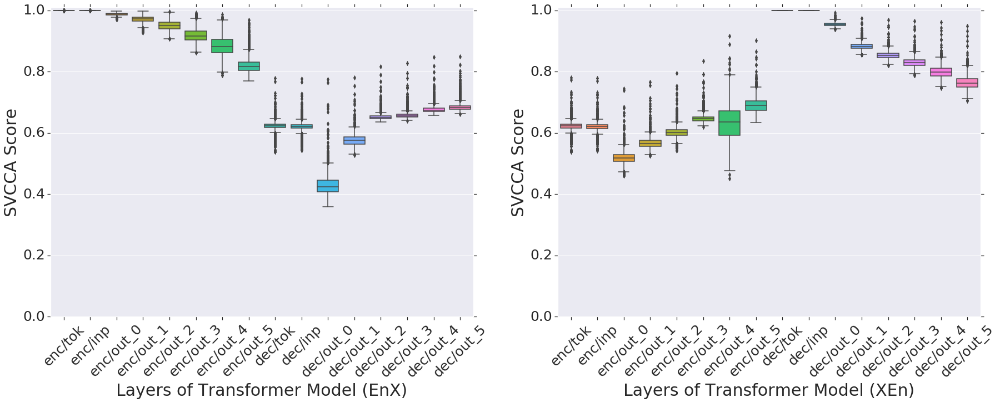

In [0]:
f, axes = plt.subplots(1, 2, figsize=(30, 10), sharex=True)
seaborn.set()

b = []
for df, key, ax in zip([df_enx, df_xen], ["(EnX)", "(XEn)"], axes):
  b.append(create_plots.layerwise_boxplot(df, key, ax, activation_list))
plt.show()

# Finetuning


In this section, we try to analyze the robustness of encoder representations, when fine-tuning a multilingual model on a particular single language pair. Note that, here we define robustness to mean representational rigidity to fine-tuning, aka robustness to catastrophic forgetting. Understanding the factors that affect robustness during fine-tuning is critical to determining how much cross-lingual transfer can be expected for individual languages in a zero or few-shot setting.

## Analysis Setup
We fine-tune a fully trained multilingual model separately on 12 Any-to-English language pairs for 40k steps. These languages were selected to form a mix of high and low resource language pairs, from 6 different language sub-families.

We first attempt to quantify the extent of distortion in language representations caused by the fine-tuning process. To this end, we calculate the SVCCA similarity between the encoder representations of a language, before and after fine-tuning. We repeat this process for all languages, in order to understand which factors determine the extent of distortion. We visualize these changes in for the final encoder layer, for all X-En language pairs. To complement our analysis of representational similarity, we also visualize the relative change in BLEU score after fine-tuning. 

In [0]:
# For readability we only look at a subset of of our language pairs.
selected_lps = get_tasks_from_properties('Sub-Family', [
 'Baltic',
 'Benue-Congo',
 'Common Turkic',
 'Germanic',
 'Indo-Iranian',
 'Khmer',
 'Malayo-Polynesian',
 'Romance',
 'Semitic',
 'Sinitic',
 'Slavic',
 'South Dravidian',                                  ])

## Change in SVCCA Before and After Finetuning

Loading BokehJS ...

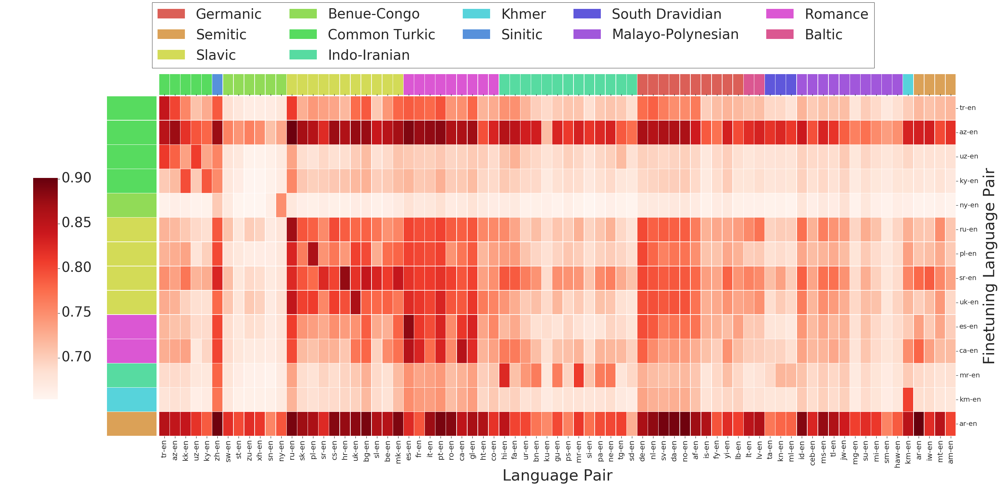

In [0]:
%no_vertical_scrollbar
output_notebook()
g = create_plots.finetuning_block(df_ft[df_ft.Layer == 'enc/out_5'], int_lps=plotting_groups['xen_int'], \
                     task_lps=lps_xen, selected_lps=selected_lps, order=order,\
                      props=prop_df,values="SVCCA Score", color="Reds")


## Relative Change in BLEU

Loading BokehJS ...

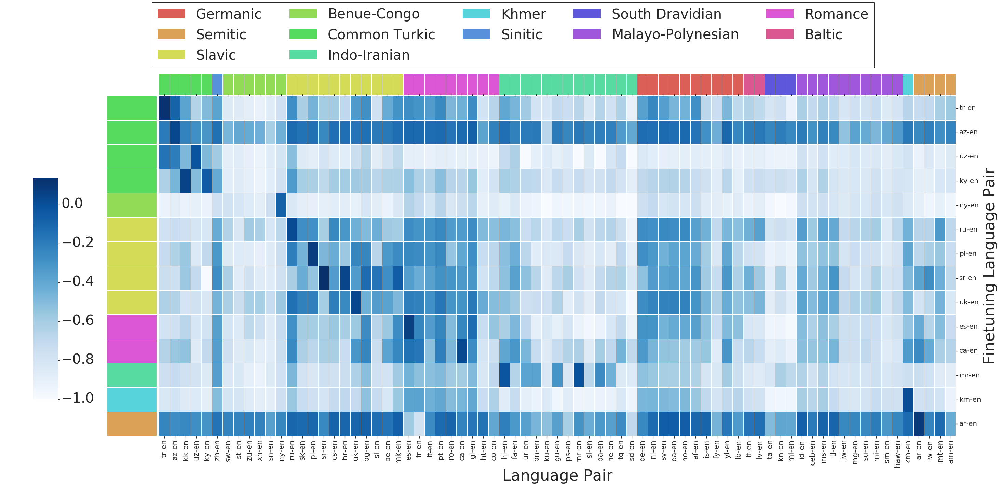

In [0]:
%no_vertical_scrollbar
output_notebook()
g = create_plots.finetuning_block(bleu_rel, int_lps=plotting_groups['xen_int'], \
                     task_lps=lps_xen, selected_lps=selected_lps, order=order,\
                      props=prop_df, values="Relative BLEU Change", color="Blues")


## Observations
The first observation from the figures above is that the variations in SVCCA scores correspond very well with changes in BLEU; degradation in translation quality is strongly correlated with the magnitude of change in representations during fine-tuning. 

We find that representations of high resource languages are quite robust to fine-tuning on any language. In the figures, we see that high resource languages such as Chinese, German, Russian and Italian do not change much, irrespective of the language the model is fine-tuned on. 

In general, we find that language representations are relatively robust to fine-tuning on a language pair from the same linguistic family. For example, on fine-tuning with tr-en (Turkish) or ky-en (Kyrgyz), the Turkic language group does not experience much shift in representation. We see a similar pattern with models fine-tuned on es-en (Spanish), ca-en (Catalan) and the Romance languages, uk-en (Ukranian), sr-en (Serbian), ru-en (Russian) and the Slavic languages.

An exception to these general trends seems to be fine-tuning on ny-en (Nyanja - Benue-Congo sub-family); all language pairs degrade by roughly the same extent, irrespective of language similarity or resource size. It's worth noting that all of the languages from the Benue-Congo sub-family are low-resource in our corpus.

These observations suggest that high resource languages might be responsible for partitioning the representation space, while low-resource languages become closely intertwined with linguistically similar high-resource languages. Low resource languages unrelated to any high resource languages have representations spread out across multiple partitions. 

While these observations are based on representations from the top of the encoder, we further analyze sensitivity of representations to fine-tuning across different layers in the Appendix. One key observation from that analysis is the robustness of embeddings to fine-tuning on any individual language; there is no significant change in the embedding representations ($\bar{\rho} > 0.98$). 

# Discussion

Our work uncovers a few interesting observations that might be of interest to practitioners working in multilingual NMT and cross-lingual transfer. Our analysis reveals that language representations cluster based on language similarity. While language similarity has been exploited for adaptation previously, our work is the first to concretely highlight which factors affect the overlap in representations across languages. This has large potential implications for transfer learning, for example, it is possible to identify and exploit the nearest neighbors of a low resource language to maximize adaptation performance.

We also highlight how representation overlap evolves across layers, which is, again, of interest for cross-lingual transfer. For example, our analysis reveals that embeddings of different languages are less overlapping than the final encoder outputs. This hints that it might not be effective to utilize cross-lingual embeddings learned in multilingual NMT, since they don't overlap as much as the final encoder outputs. We also notice that encoder representation overlap across languages is not perfect, which explains why explicit language alignment or consistency losses might be needed to enable zero-shot NMT.

We further analyzed the robustness of language representations to fine-tuning, and noticed that high-resource and linguistically similar languages are more robust to fine-tuning on an arbitrary language. This might help explain why linguistically distant languages typically result in poor zero-shot transfer. Applying explicit losses, like elastic-weight consolidation, to force language representations of distant languages from getting distorted might help improve transfer performance.


To conclude, we analyzed factors that affect the overlap in representations learned by multilingual NMT models. We used SVCCA to show that
multilingual neural networks share representations across languages strongly along the lines of linguistic similarity, and encoder representations diverge based on the target language. With this work we hope to inspire future work on understanding multitask and multilingual NLP models.